# Learning Algorithms

CSI 4106 - Fall 2025

Marcel Turcotte  
Version: Sep 16, 2025 10:02

# Preamble

## Message of the Day

<https://www.youtube.com/watch?v=OmzzoJM5YQM>

[Microsoft boss troubled by rise in reports of ‘AI
psychosis’](https://www.youtube.com/watch?v=OmzzoJM5YQM), BBC News,
2025-08-21.

Large language models exhibit remarkable linguistic capabilities,
prompting an increasing number of individuals to engage in personal
dialogues with them. Murray Shanahan, affiliated with Google DeepMind
and Imperial College, introduces an compelling framework for examining
the “behavior” of these models. He conceptualizes their interactions
through the lens of role play, as discussed in his recent work
[published in
Nature](https://www.nature.com/articles/s41586-023-06647-8).

-   [Consciousness, reasoning and the philosophy of AI with Murray
    Shanahan](https://www.youtube.com/watch?v=v1Py_hWcmkU), in this
    Google DeepMind podcast, Hannah Fry interviews Murray Shanahan,
    2025-04-24.

Depending on the context of their interaction prompts, these models can
adopt personas that simulate malevolent individuals, potentially
offering advice with harmful consequences.

-   [OpenAI Eagerly Trying To Reduce AI Psychosis And Squash Co-Creation
    Of Human-AI Delusions When Using ChatGPT And GPT-5](), by Lance
    Eliot, Forbes, 2025-09-02.
-   [What to know about ‘AI psychosis’ and the effect of AI chatbots on
    mental
    health](https://www.pbs.org/newshour/show/what-to-know-about-ai-psychosis-and-the-effect-of-ai-chatbots-on-mental-health),
    PBS News, 2025-08-31.

Here is a reminder for the University of Ottawa’s wellness page, which
offers a comprehensive array of resources, including medical and mental
health-care services, designed to support your well-being and that of
those around you.

-   [Student Health and
    Wellness](https://www.uottawa.ca/campus-life/health-wellness)

## Learning outcomes

-   **Differentiate** between model, objective, and optimizer in
    learning algorithms.
-   **Explain** KNN for classification and regression, including uniform
    and distance-weighted prediction.
-   **Describe** decision trees and **apply** the split criterion using
    impurity measures such as Gini.
-   **Interpret** decision boundaries and the concept of linear
    separability.

As indicated in the introductory lecture, I aim to present a series of
concepts leading to deep learning. As a starting point, linear
regression would be a logical choice as a primary learning algorithm to
examine. Nonetheless, it is equally critical to possess a high-level
understanding of various other learning algorithms, as they differ
significantly in model structures and training processes. Therefore, I
will briefly discuss k-nearest neighbours and decision trees, before
introducing linear regression.

# KNN

## k-nearest neighbours (KNN)

![](https://scikit-learn.org/stable/_images/sphx_glr_plot_classification_001.png)

-   [KNeighborsClassifier](https://scikit-learn.org/stable/modules/generated/sklearn.neighbors.KNeighborsClassifier.html#sklearn.neighbors.KNeighborsClassifier),
    [examples](https://scikit-learn.org/stable/auto_examples/neighbors/plot_classification.html)
-   [KNeighborsRegressor](https://scikit-learn.org/stable/modules/generated/sklearn.neighbors.KNeighborsRegressor.html),
    [exemples](https://scikit-learn.org/stable/auto_examples/neighbors/plot_regression.html)

**Attribution**: [Nearest Neighbors
Classification](https://scikit-learn.org/stable/auto_examples/neighbors/plot_classification.html).

## KNN - Learning

-   *Lazy learning*: no explicit training
-   The “model” is the dataset

The **k-nearest neighbour** (KNN) algorithm simply stores its training
data. There is no explicit training. We call this “lazy learning”.

When the number of examples is large, the low-dimensional data can be
stored in a specialized data structure, such as kd-tree or ball tree, to
accelerate the computation at inference time. For high-dimensional data,
techniques, such as approximate nearest neighbour (ANN) have been
developped.

## KNN - Inference

-   Classify/regress based on the labels/values of the $k$ closest
    examples in feature space

Cost is $\mathcal{O}(ND)$ per query (naïve), where $N$ = number of
examples, $D$ = dimensions

Although the inference cost may seem low, being linear with respect to
the number of examples. It is important to remember that the typical
workflow for a machine learning project is to train a model once and use
that model for every query, where the number of queries can be quite
large.

## Formal Definition

Given **dataset** $\{(x_i, y_i)\}_1^{N}$ and an **unseen example** $x$:

-   Compute **distances** $d(x, x_i)$
-   Select the **$k$ smallest distances**
-   Classification: **majority vote** (possibly weighted by $1/d$)
-   Regression: **average** (possibly weighted)

The **k-nearest neighbour** (KNN) algorithm is a simple,
**non-parametric**, **instance-based** learning method used for
classification and regression. It classifies a data point based on the
majority label of its $k$ nearest neighbours in the feature space, where
$k$ is a user-defined constant. Distance metrics like Euclidean distance
are commonly used to determine the nearest neighbours.

In the context of regression, the predicted value $\hat{y}(x)$ is
calculated as a weighted sum of the labels of its $k$ nearest
neighbours. The weights can be uniform or based on distance, reflecting
the proximity of each neighbour to the query point $x$.

For a query point $x$, let its $k$ nearest neighbours have targets
$y_1, \dots, y_k$ and distances $d_1, \dots, d_k$.

-   **Uniform weights (default)**:

$$
\hat{y}(x) = \frac{1}{k} \sum_{i=1}^k y_i
$$

-   **Distance weights** (the built-in option `"distance"`):

$$
\hat{y}(x) = \frac{\sum_{i=1}^k \frac{1}{d_i} \, y_i}{\sum_{i=1}^k \frac{1}{d_i}}
$$

In the above, as the distance $d_i$ between the example $x_i$ and the
example $x$ increases, the reciprocal $\frac{1}{d_i}$ decreases.
Consequently, examples that are farther from $x$ exert less influence on
the predicted outcome, $\hat{y}(x)$.

In both cases, convex combination property guarantees that:

$$
\min(y_1, \dots, y_k) \;\; \leq \;\; \hat{y}(x) \;\; \leq \;\; \max(y_1, \dots, y_k).
$$

A **non-parametric** algorithm does not make any assumptions about the
underlying data distribution and does not learn a fixed set of
parameters or a model during the training phase. Instead, it relies
directly on the training data to make decisions at the time of
classification or regression, making it flexible and adaptive to various
data shapes but potentially computationally expensive at prediction
time.

KNN has clear limitations:

1.  **Computational cost**
    -   Prediction requires computing distances to all training points,
        $O(n)$ per query.
2.  **Curse of dimensionality**
    -   In high-dimensional spaces, distance metrics lose discriminative
        power.
3.  **Choice of $k$ and distance metric**
    -   Small $k$: high variance, sensitive to noise/outliers.
    -   Large $k$: high bias, oversmoothing.
4.  **Sensitivity to feature scaling**
    -   Distances are scale-dependent; variables with larger ranges
        dominate unless features are normalized/standardized.
5.  **Imbalanced data**
    -   In classification, if one class is much more frequent, KNN can
        be biased toward that class since neighbours are more likely to
        belong to it.
6.  **Not extrapolative**
    -   Predictions are always convex combinations (in regression) or
        majority votes (in classification) of training labels.
    -   This means KNN cannot extrapolate trends outside the range of
        observed training data.

In scikit-learn, several models are commonly used for regression tasks.
Here are some of the main models:

1.  **Linear Regression** (`LinearRegression`):
    -   A simple linear approach that models the relationship between
        the independent variables and the dependent variable by fitting
        a linear equation to the observed data.
2.  **Support Vector Regression** (`SVR`):
    -   An extension of Support Vector Machines (SVM) for regression
        tasks, which tries to fit the best line within a specified
        margin of tolerance.
3.  **Decision Tree Regression** (`DecisionTreeRegressor`):
    -   Uses decision trees to model the relationship between the input
        features and the target variable by recursively splitting the
        data into subsets.
4.  **Random Forest Regression** (`RandomForestRegressor`):
    -   An ensemble method that uses multiple decision trees to improve
        predictive accuracy and control overfitting.
5.  **Gradient Boosting Regression** (`GradientBoostingRegressor`):
    -   Another ensemble method that builds sequential decision trees,
        where each tree corrects the errors of the previous one.
6.  **K-Nearest Neighbors Regression** (`KNeighborsRegressor`):
    -   A non-parametric method that predicts the target variable based
        on the average of the k-nearest neighbours in the feature space.

These models offer a range of approaches to handle different types of
regression problems, each with its own strengths and suitable
applications.

## Exercises

Download these examples to experiment with code variations. Notably,
examine how **changes in $k$** impact **classification decision
boundaries** and **regression line smoothness**.

-   [Nearest Neighbors
    Classification](https://scikit-learn.org/stable/auto_examples/neighbors/plot_classification.html)
-   [Nearest Neighbors
    Regression](https://scikit-learn.org/stable/auto_examples/neighbors/plot_regression.html)
-   [Importance of Feature
    Scaling](https://scikit-learn.org/stable/auto_examples/preprocessing/plot_scaling_importance.html)

The scikit-learn website offers
[examples](https://scikit-learn.org/stable/auto_examples/index.html) in
Jupyter Notebook format, accessible via desktop browsers with links on
the right.

# Decision Tree

## Interpretable

![](https://www.canada.ca/content/dam/phac-aspc/images/services/reports-publications/health-promotion-chronic-disease-prevention-canada-research-policy-practice/vol-43-no-2-2023/a3f1-en.jpg)

**Attribution:** [Public Health Agency of
Canada](https://www.canada.ca/en/public-health/services/reports-publications/health-promotion-chronic-disease-prevention-canada-research-policy-practice/vol-43-no-2-2023/decision-trees-population-health-surveillance-research-youth-mental-health-compass-study.html)

Decision trees are valuable because they clearly delineate the rules
learned by the model. The decision tree above illustrates the results of
a study examining clinically significant anxiety symptoms. In this
instance, the initial determinant was whether students reported having a
positive home environment.

## What is a Decision Tree?

-   A decision tree is a **hierarchical structure** represented as a
    directed acyclic graph, used for **classification** and
    **regression** tasks.
-   Each **internal node** performs a binary test on a particular
    feature ($j$), such as evaluating whether the number of connections
    at a school surpasses a specified threshold.
-   The **leaves** function as decision nodes.

The tree’s **structure** is **inferred** (**learnt**) from the
**training data**.

Decision trees can extend beyond binary splits, as exemplified by
algorithms like **ID3**, which accommodate nodes with multiple children.

## Classifying New Instances (Inference)

-   Begin at the **root** node of the decision tree. Proceed by
    answering a sequence of **binary questions** until a **leaf node**
    is reached. The label associated with this leaf denotes the
    **classification** of the instance.
-   Alternatively, some algorithms may store a **probability
    distribution** at the leaf, representing the fraction of training
    samples corresponding to each class $k$, across all possible classes
    $k$.

When a **decision tree** is used to solve a **regression** task, each
**leaf node** stores a **prediction value**. Specifically:

$$
\hat{y}_\text{leaf} = \frac{1}{N_\text{leaf}} \sum_{i \in \text{leaf}} y_i,
$$

where $N_\text{leaf}$ is the number of training samples that ended up in
that leaf, and $y_i$ are their target values.

# Decision Boundary

## Palmer Pinguins Dataset

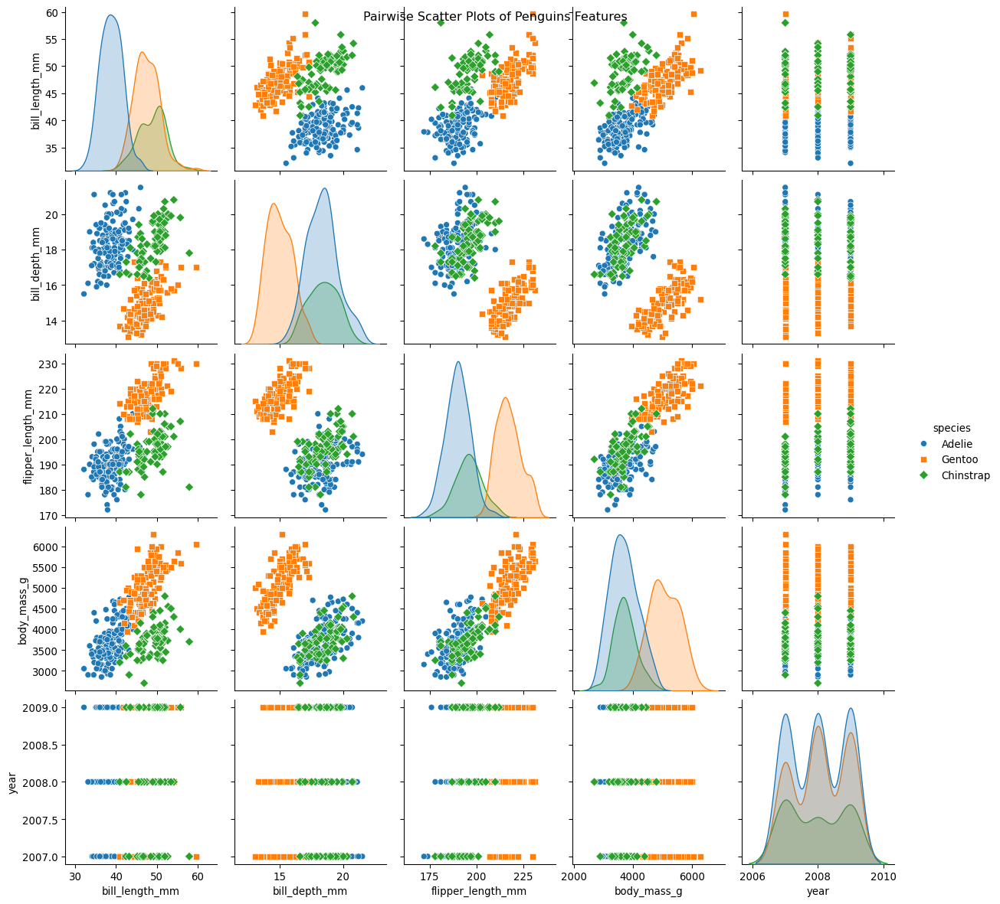

In [1]:
# Loading our dataset

try:
  from palmerpenguins import load_penguins
except:
  ! pip install palmerpenguins
  from palmerpenguins import load_penguins

penguins = load_penguins()

# Pairplot using seaborn

import matplotlib.pyplot as plt
import seaborn as sns

sns.pairplot(penguins, hue='species', markers=["o", "s", "D"])
plt.suptitle("Pairwise Scatter Plots of Penguins Features")
plt.show()

## Binary Classification Problem

-   Several scatter plots reveal a distinct clustering of **Gentoo**
    instances.
-   To illustrate our next exemple, we propose a **binary
    classification** model: **Gentoo** versus **non-Gentoo**.
-   Our analysis will concentrate on two key features: **body mass** and
    **bill depth**.

## Definition

A **decision boundary** is a “boundary” that partitions the underlying
feature space into **regions** corresponding to **different class
labels**.

The term **boundary** will be clarified over the next slides.

## Decision Boundary

The decision boundary between these attributes can be represented as a
**line**.

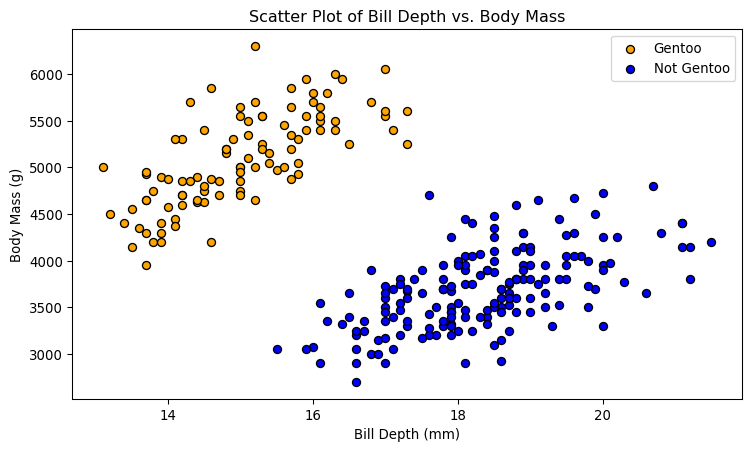

In [2]:
# Import necessary libraries
import numpy as np
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

try:
  from palmerpenguins import load_penguins
except:
  ! pip install palmerpenguins
  from palmerpenguins import load_penguins

# Load the Palmer Penguins dataset
df = load_penguins()

# Preserve only the necessary features: 'bill_depth_mm' and 'body_mass_g'
features = ['bill_depth_mm', 'body_mass_g']
df = df[features + ['species']]

# Drop rows with missing values
df.dropna(inplace=True)

# Create a binary problem: 'Gentoo' vs 'Not Gentoo'
df['species_binary'] = df['species'].apply(lambda x: 1 if x == 'Gentoo' else 0)

# Define feature matrix X and target vector y
X = df[features].values
y = df['species_binary'].values

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Function to plot initial scatter of data
def plot_scatter(X, y):
    plt.figure(figsize=(9, 5))
    plt.scatter(X[y == 1, 0], X[y == 1, 1], color='orange', edgecolors='k', marker='o', label='Gentoo')
    plt.scatter(X[y == 0, 0], X[y == 0, 1], color='blue', edgecolors='k', marker='o', label='Not Gentoo')
    plt.xlabel('Bill Depth (mm)')
    plt.ylabel('Body Mass (g)')
    plt.title('Scatter Plot of Bill Depth vs. Body Mass')
    plt.legend()
    plt.show()
    
# Plot the initial scatter plot
plot_scatter(X_train, y_train)

## Decision Boundary

The decision boundary between these attributes can be represented as a
**line**.

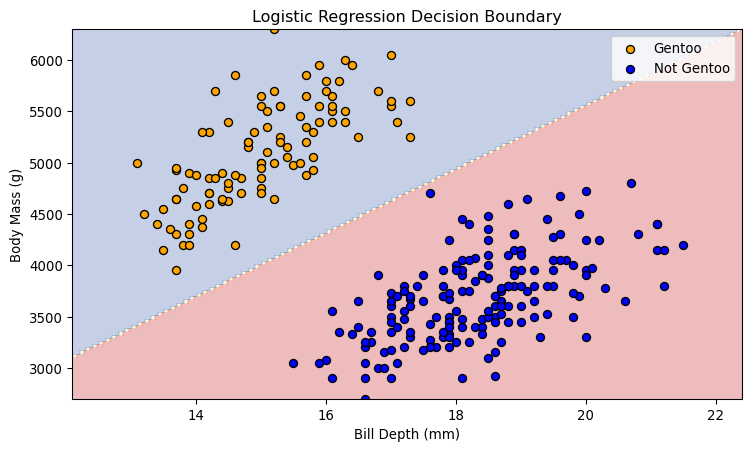

In [3]:
# Train a logistic regression model
model = LogisticRegression()
model.fit(X_train, y_train)

# Function to plot decision boundary
def plot_decision_boundary(X, y, model):
    x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
    y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.1),
                         np.arange(y_min, y_max, 0.1))
    Z = model.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    
    plt.figure(figsize=(9, 5))
    plt.contourf(xx, yy, Z, alpha=0.3, cmap='RdYlBu')
    plt.scatter(X[y == 1, 0], X[y == 1, 1], color='orange', edgecolors='k', marker='o', label='Gentoo')
    plt.scatter(X[y == 0, 0], X[y == 0, 1], color='blue', edgecolors='k', marker='o', label='Not Gentoo')
    plt.xlabel('Bill Depth (mm)')
    plt.ylabel('Body Mass (g)')
    plt.title('Logistic Regression Decision Boundary')
    plt.legend()
    plt.show()

# Plot the decision boundary on the training set
plot_decision_boundary(X_train, y_train, model)

## Definition

We say that the data is **linearly separable** when two classes of data
can be perfectly separated by a **single linear boundary**, such as a
**line** in **two-dimensional space** or a **hyperplane in higher
dimensions**.

## Simple Decision Doundary

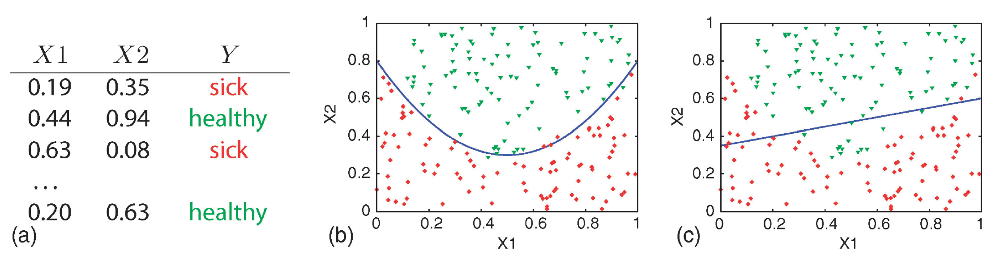

*(a)* training data, *(b)* quadratic curve, and *(c)* linear function.

**Attribution:** (Geurts, Irrthum, and Wehenkel 2009)

The table on the left presents training data for a hypothetical **binary
classification task** in a medical context, where the two attributes,
$X_1$ and $X_2$, are used to predict the target variable, $y$, which can
take on two values: *sick* and *healthy*. You can imagine that $X_1$ and
$X_2$ are measurements, such as blood pressure and heart rate or
cholesterol and glucose levels.

**Logistic regression** (c) employs a linear **decision boundary**. In
this specific example, the decision boundary is represented by a
straight line. Employing logistic regression for this problem results in
several classification errors: red dots above the line, which should be
classified as ‘sick’, are incorrectly predicted as ‘healthy’.
Conversely, green dots below the line, which should be classified as
‘healthy’, are incorrectly predicted as ‘sick’.

## Complex Decision Boundary

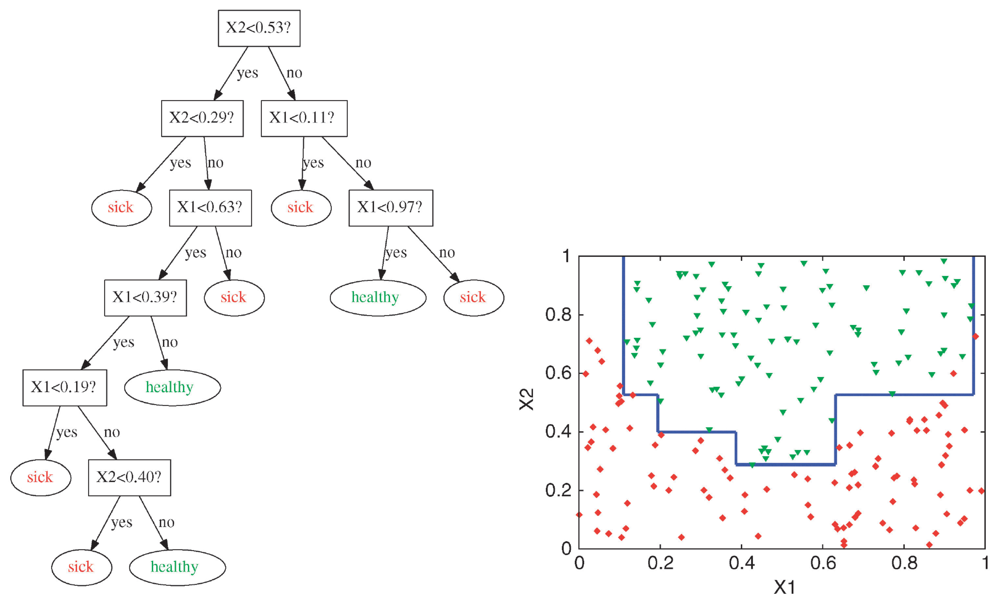

**Decision trees** are capable of generating **irregular** and
**non-linear** decision boundaries.

**Attribution:** *ibidem*.

Make sure to understand the relationships between the eight decision
rules delineated in the decision tree and the nine line segments
represented in the scatter plot.

## Definition (revised)

A **decision boundary** is a hypersurface that partitions the underlying
feature space into **regions** corresponding to **different class
labels**.

# Decision Tree (contd)

## Constructing a Decision Tree

-   How to **construct** (**learnt**) a decision tree?

-   Are there some trees that are **“better”** than others?

-   Is it feasible to construct an **optimal decision tree** with
    computational efficiency?

(Hyafil and Rivest 1976)

## Optimality

-   Let $X = \{x_1, \ldots, x_n\}$ be a finite set of **objects**.
-   Let $\mathcal{T} = \{T_1, \ldots, T_t\}$ be a finite set of
    **tests**.
-   For each object and test, we have:
    -   $T_i(x_j)$ is either **true** or **false**.
-   An **optimal** tree is one that completely identifies all the
    objects in $X$ and $|T|$ is **minimum**.

(Hyafil and Rivest 1976)

Hyafil and Rivest (1976) showed that constructing optimal binary
decision trees is NP-Complete.

## Constructing a Decision Tree

-   **Iterative development**: Initiate with an **empty tree**.
    Progressively introduce **nodes**, each informed by the **training
    dataset**, continuing until the dataset is **completely classified**
    or alternative termination criteria, such as **maximum tree depth**,
    are met.

**Learning** is the process of building the tree from training data.

## Constructing a Decision Tree

-   **Initial Node Construction**:
    -   To establish the root node, evaluate all available $D$ features.
        -   For each feature, assess various threshold values derived
            from the observed data within the training set.

## Constructing a Decision Tree

-   For a **numerical feature**, the algorithm considers **all possible
    split points** (thresholds) in the feature’s range.
-   These split points are typically the **midpoints** between two
    consecutive, **sorted unique values** of the feature.

## Constructing a Decision Tree

-   For a **categorical feature** with $k$ unique values, the algorithm
    considers **all possible ways** of splitting the categories into two
    groups.
-   For instance, if the feature (forecast) has values, ‘Rainy’,
    ‘Cloudy’, and ‘Sunny’, it evaluates the following splits:
    -   $\{\mathrm{Rainy}\}$ vs. $\{\mathrm{Cloudy}, \mathrm{Sunny}\}$,
    -   $\{\mathrm{Cloudy}\}$ vs. $\{\mathrm{Rainy}, \mathrm{Sunny}\}$ ,
    -   $\{\mathrm{Sunny}\}$ vs. $\{\mathrm{Rainy}, \mathrm{Cloudy}\}$.

## Evaluation

What defines a **“good” data split**?

-   $\{\mathrm{Rainy}\}$ vs. $\{\mathrm{Cloudy}, \mathrm{Sunny}\}$ :
    $[20,10,5]$ and $[10,10,15]$.
-   $\{\mathrm{Cloudy}\}$ vs. $\{\mathrm{Rainy}, \mathrm{Sunny}\}$ :
    $[40,0,0]$ and $[0,30,0]$.

Where $[20,10,5]$ indicates that the subgroup contains 20 examples of
the ‘Poor’, 10 for ‘Average’, and 5 for ‘Excellent’, for our predictive
model to classify the likelihood of a successful fishing day.

## Evaluation

-   **Heterogeneity** (also referred to as **impurity**) and
    **homogeneity** are critical metrics for evaluating the composition
    of resulting data partitions.

-   Optimally, each of these partitions should contain data entries from
    a **single class** to achieve maximum homogeneity.

-   **Entropy** and the **Gini index** are two widely utilized metrics
    for assessing these characteristics.

## Evalution

Objective function for **sklearn.tree.DecisionTreeClassifier** (CART):

$$
  J(k,t_k) = \frac{N_{\text{left}}}{N_{\text{parent}}} G_{\text{left}} + \frac{N_{\text{right}}}{N_{\text{parent}}} G_{\text{right}}
$$

-   The cost of partitioning the data using **feature** $k$ and
    **threshold** $t_k$.

-   $N_{\text{left}}$ and $N_{\text{right}}$ is the **number of
    examples** in the **left** and **right** subsets, respectively, and
    $N_{\text{parent}}$ is the number of examples before splitting the
    data.

-   $G_{\text{left}}$ and $G_{\text{right}}$ is the **impurity** of the
    **left** and **right** subsets, respectively.

Minimize or maximize $J$?

## Gini Index

-   **Gini index** (default)

$$
  G_i = 1 - \sum_{k=1}^n p_{i,k}^2
$$

-   $p_{i,k}$ is the proportion of the examples from this class $k$ in
    the node $i$.

-   What is the **maximum** value of the Gini index?

-   The value of the Gini index is maximum when all the classes are
    equiprobable, i.e. the proportions are the same.

-   For a binary classification,
    $1 - [\frac{1}{2}^2 + \frac{1}{2}^2] = 0.5$.

-   For the general case,
    $1 - n \times \frac{1}{n}^2 = 1 - \frac{1}{n}$, as $n \to \infty$,
    $\frac{1}{n} \to 0$, and the Gini index tends to 1.

## Gini Index

Considering a **binary classification** problem:

-   $1 - [(0/100)^2 + (100/100)^2] = 0$ (pure)
-   $1 - [(25/100)^2 + (75/100)^2] = 0.375$
-   $1 - [(50/100)^2 + (50/100)^2] = 0.5$

Based on the above, are we solving a minimization or maximization
problem?

When the problem is formulated as follows:

-   For each candidate split $(k, t_k)$, compute

$$
  J(k,t_k) = \frac{N_{\text{left}}}{N_{\text{parent}}} G_{\text{left}} + \frac{N_{\text{right}}}{N_{\text{parent}}} G_{\text{right}}
$$

-   The algorithm then chooses the split with the **lowest** $J$,
    i.e. the split that yields the smallest weighted impurity.

Many textbooks describe this as **maximizing impurity reduction
(information gain)**, which is just

$$
\Delta G = G_{\text{parent}} - J(k,t_k).
$$

Maximizing $\Delta G$ has benefits.

If no potential split for a given parent node leads to a reduction in
impurity, the recursive process of node splitting halts. In this
scenario, the classification performance of the parent node surpasses
that of any possible split.

If the algorithm is considering splitting a parent node, it means the
$G_{\text{parent}} > 0$, otherwise the process would have stopped.

What about $\frac{N_{\text{left}}}{N_{\text{parent}}}$ and
$\frac{N_{\text{right}}}{N_{\text{parent}}}$?

What happens if the number of examples in one child is very small?

Suppose we isolate 1 sample (pure) into the left child, and leave $N-1$
mixed in the right child.

-   Left child: $G_{left} = 0$, weight = $1/N$.
-   Right child: $G_{right} \approx G_{parent}$, weighted by $(N-1)/N$.

Thus $$
   J(k,t_k) \;\approx\; \frac{N-1}{N} \, G_{\textrm{parent}} ,
$$

therefore

$$
\Delta \;\approx\; \, G_{\textrm{parent}} - \frac{N-1}{N} \, G_{\textrm{parent}} = \frac{1}{N} \, G_{\textrm{parent}}.
$$

That’s only a tiny gain (shrinks as $N$ grows).

## Gini Index

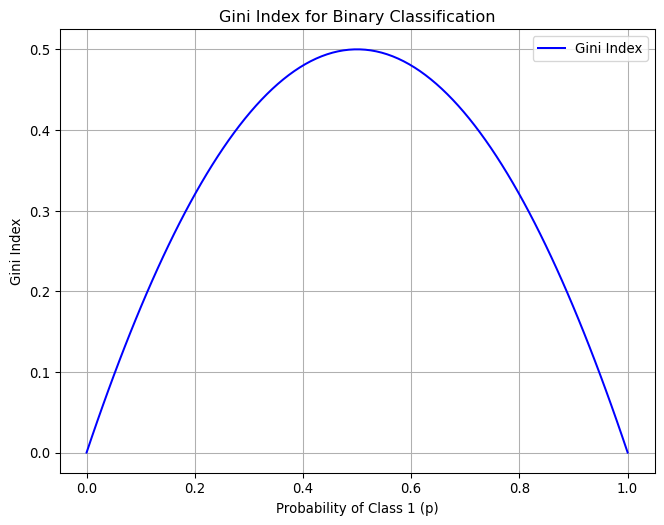

In [4]:
def gini_index(p):
    """Calculate the Gini index."""
    return 1 - (p**2 + (1 - p)**2)

# Probability values for class 1
p_values = np.linspace(0, 1, 100)

# Calculate Gini index for each probability
gini_values = [gini_index(p) for p in p_values]

# Plot the Gini index
plt.figure(figsize=(8, 6))
plt.plot(p_values, gini_values, label='Gini Index', color='b')
plt.title('Gini Index for Binary Classification')
plt.xlabel('Probability of Class 1 (p)')
plt.ylabel('Gini Index')
plt.grid(True)
plt.legend()
plt.show()

## Iris Dataset

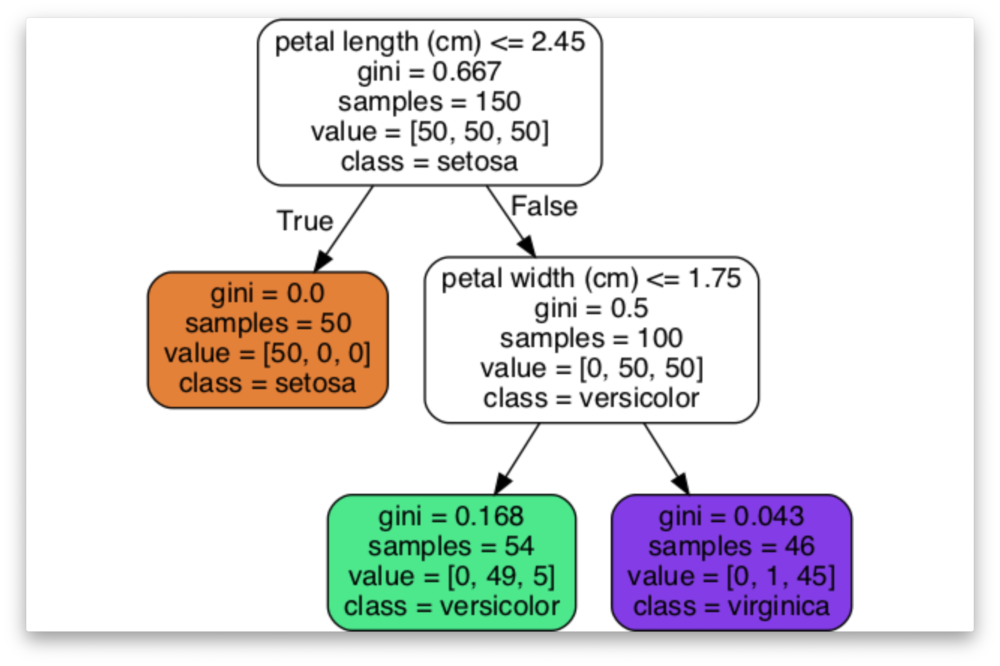

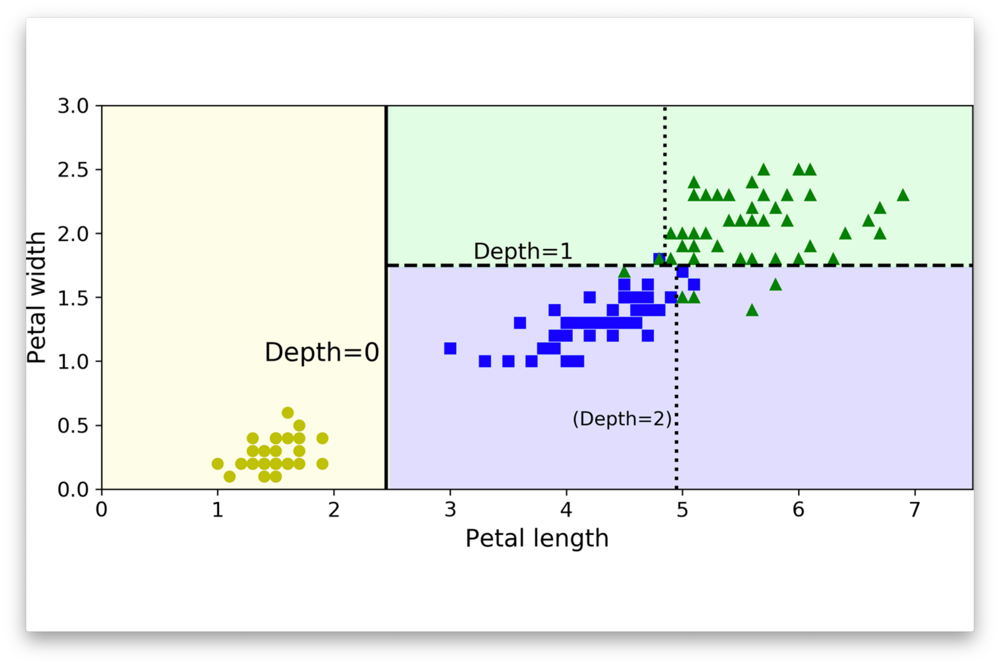

**Attribution:** (Géron 2019), Figures 6.1 and 6.2

## Complete Example

<https://www.youtube.com/watch?v=_L39rN6gz7Y>

[Decision and Classification Trees, Clearly
Explained!!!](https://www.youtube.com/watch?v=_L39rN6gz7Y), (18 m 7s)
[StatQuest](https://www.youtube.com/@statquest/videos), 2021-04-26

## Stopping Criteria

-   All the examples in a given node belong to the **same class**.
-   Depth of the tree would exceed **max_depth**.
-   Number of examples in the node is **min_sample_split** or less.
-   None of the splits decreases impurity sufficiently
    (**min_impurity_decrease**).
-   See documentation for other criteria.

## Limitations

-   Possibly creates **large trees**
    -   Challenge for **interpretation**
    -   **Overfitting**
-   **Greedy algorithm**, no guarantee to find the optimal tree. (Hyafil
    and Rivest 1976)
-   **Small changes** to the data set produce **vastly different trees**

## Large Trees

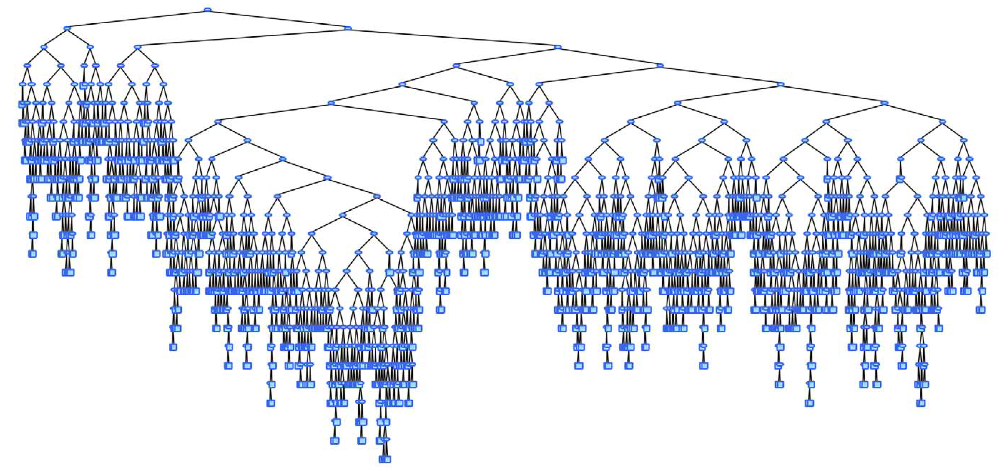

(Stiglic et al. 2012)

## Small Changes to the Dataset

Seed: 4

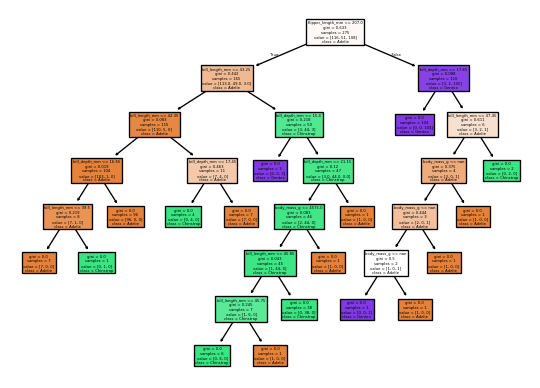

Accuracy: 0.99
Classification Report:
              precision    recall  f1-score   support

      Adelie       1.00      0.97      0.99        36
   Chinstrap       0.94      1.00      0.97        17
      Gentoo       1.00      1.00      1.00        16

    accuracy                           0.99        69
   macro avg       0.98      0.99      0.99        69
weighted avg       0.99      0.99      0.99        69

Seed: 7

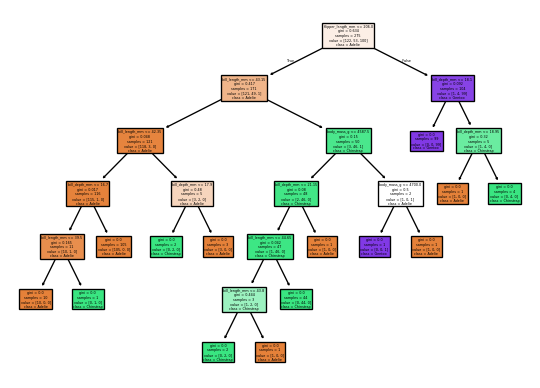

Accuracy: 0.91
Classification Report:
              precision    recall  f1-score   support

      Adelie       0.96      0.83      0.89        30
   Chinstrap       0.83      1.00      0.91        15
      Gentoo       0.92      0.96      0.94        24

    accuracy                           0.91        69
   macro avg       0.90      0.93      0.91        69
weighted avg       0.92      0.91      0.91        69

Seed: 90

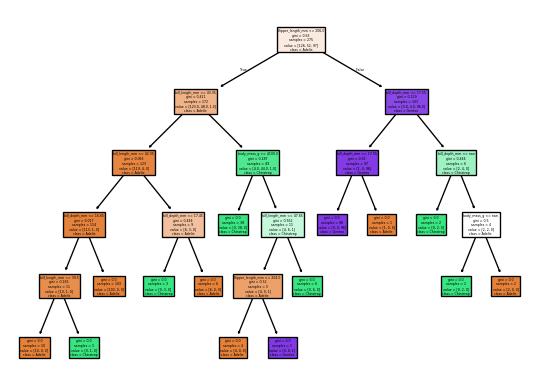

Accuracy: 0.94
Classification Report:
              precision    recall  f1-score   support

      Adelie       0.90      1.00      0.95        26
   Chinstrap       0.93      0.88      0.90        16
      Gentoo       1.00      0.93      0.96        27

    accuracy                           0.94        69
   macro avg       0.94      0.93      0.94        69
weighted avg       0.95      0.94      0.94        69

Seed: 96

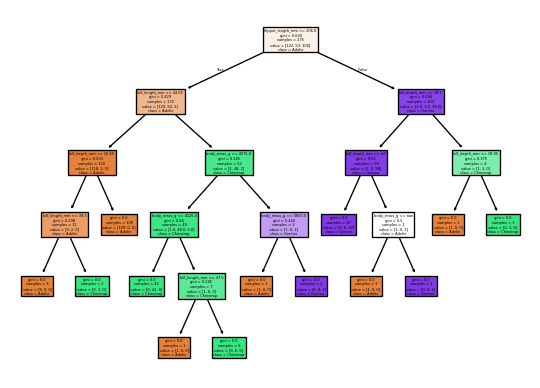

Accuracy: 0.90
Classification Report:
              precision    recall  f1-score   support

      Adelie       0.83      0.97      0.89        30
   Chinstrap       1.00      0.67      0.80        15
      Gentoo       0.96      0.96      0.96        24

    accuracy                           0.90        69
   macro avg       0.93      0.86      0.88        69
weighted avg       0.91      0.90      0.90        69

Seed: 99

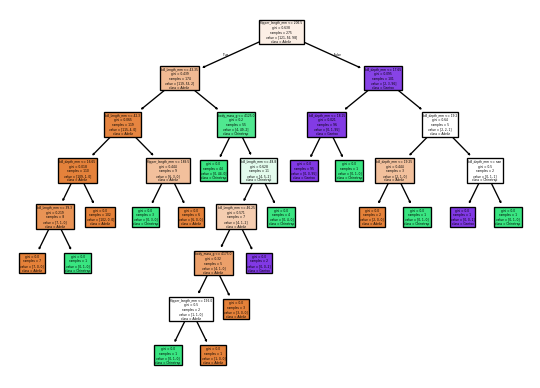

Accuracy: 1.00
Classification Report:
              precision    recall  f1-score   support

      Adelie       1.00      1.00      1.00        31
   Chinstrap       1.00      1.00      1.00        12
      Gentoo       1.00      1.00      1.00        26

    accuracy                           1.00        69
   macro avg       1.00      1.00      1.00        69
weighted avg       1.00      1.00      1.00        69

Seed: 2

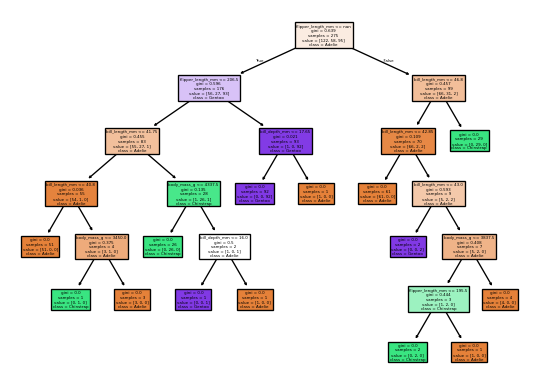

Accuracy: 0.55
Classification Report:
              precision    recall  f1-score   support

      Adelie       0.62      0.97      0.75        30
   Chinstrap       0.43      0.90      0.58        10
      Gentoo       0.00      0.00      0.00        29

    accuracy                           0.55        69
   macro avg       0.35      0.62      0.44        69
weighted avg       0.33      0.55      0.41        69


In [5]:
from sklearn import tree
from sklearn.metrics import classification_report, accuracy_score

# Loading the dataset

X, y = load_penguins(return_X_y = True)

target_names = ['Adelie','Chinstrap','Gentoo']

# Split the dataset into training and testing sets

for seed in (4, 7, 90, 96, 99, 2):

  print(f'Seed: {seed}')

  # Create new training and test sets based on a different random seed

  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

  # Creating a new classifier

  clf = tree.DecisionTreeClassifier(random_state=seed)

  # Training

  clf.fit(X_train, y_train)

  # Make predictions

  y_pred = clf.predict(X_test)

  # Plotting the tree

  tree.plot_tree(clf, 
               feature_names = X.columns,
               class_names = target_names,
               filled = True)
  plt.show()

  # Evaluating the model

  accuracy = accuracy_score(y_test, y_pred)

  report = classification_report(y_test, y_pred, target_names=target_names)

  print(f'Accuracy: {accuracy:.2f}')
  print('Classification Report:')
  print(report)

## Summary

-   The lecture surveyed three learning algorithms, **k-nearest
    neighbours (KNN)**, **decision trees**, and **linear regression**,
    and framed them via model, objective, and optimization.
-   We then **constructed decision trees**, showed that regression
    leaves returned the sample mean, minimized the weighted impurity
    $J$, and analyzed the Gini index.
-   **Decision boundaries** were illustrated for linear and non-linear
    models.

# Prologue

## Resources

-   [Plot the decision surface of decision trees trained on the iris
    dataset](https://scikit-learn.org/stable/auto_examples/tree/plot_iris_dtc.html)
    from `sklearn`
-   [Decision
    trees](https://kirenz.github.io/classification/docs/trees.html) by
    [Jan Kirenz](https://kirenz.github.io), a Professor at HdM Stuttgart
-   [CS 320 Apr12-2021 (Part 2) - Decision
    Boundaries](https://www.youtube.com/watch?v=cWYgtUU9COg) by [Tyler
    Caraza-Harter](https://tyler.caraza-harter.com), an Instructor at
    UW-Madison

## References

Géron, Aurélien. 2019. *Hands-on Machine Learning with Scikit-Learn,
Keras, and TensorFlow*. 2nd ed. O’Reilly Media.

Geurts, Pierre, Alexandre Irrthum, and Louis Wehenkel. 2009. “Supervised
Learning with Decision Tree-Based Methods in Computational and Systems
Biology.” *Molecular bioSystems* 5 (12): 1593–1605.
<https://doi.org/10.1039/b907946g>.

Hyafil, Laurent, and Ronald L. Rivest. 1976. “Constructing Optimal
Binary Decision Trees Is NP-Complete.” *Inf. Process. Lett.* 5 (1):
15–17. <https://doi.org/10.1016/0020-0190(76)90095-8>.

Russell, Stuart, and Peter Norvig. 2020. *Artificial Intelligence: A
Modern Approach*. 4th ed. Pearson. <http://aima.cs.berkeley.edu/>.

Stiglic, Gregor, Simon Kocbek, Igor Pernek, and Peter Kokol. 2012.
“Comprehensive Decision Tree Models in Bioinformatics.” Edited by Ahmed
Moustafa. *PLoS ONE* 7 (3): e33812.
<https://doi.org/10.1371/journal.pone.0033812>.

## Next lecture

-   Training a linear model

------------------------------------------------------------------------

Marcel **Turcotte**

<Marcel.Turcotte@uOttawa.ca>

School of Electrical Engineering and **Computer Science** (EE**CS**)

University of Ottawa